---
* **Universidad:** UOC (Universitat Oberta de Catalunya)
* **Titulación:** Master Ciencia de Datos/TFM
* **Título:** Segmentación de imágenes utilizando Redes Generativas Antagónicas
* **Actividad**: Segmentación partes cuerpo personas con armas cortas utilizando modelos pre entrenados
* **Autor:** Miguel Ponce
* **Correo:** miguelalejoponce@uoc.edu
* **Fecha:** "Enero, 04 de 2023"
* **Salida**: ipynb
---
## Contexto: Modelo detección de personas armadas

* **Contexto:**
Se desea crear un modelo que permita segmentar ha personas con armas cortas.

* **Problema:** 
El objetivo de la proyecto es permitir que mediante las técnicas de mejoras en la segmentación de objetos en imágenes se puedan proponer nuevos sistemas de vigilancia y alerta temprana contra sospechosos de intento de asesinato y porte ilegal de armas. Es necesrio crear un modelo de segmentación de personas con armadas con armas cortas, basados en un conjunto de datos pre-entrenado mediante el uso de redes GAN y arquitecturtas pensadas para la segmentación de objetos.

* **Solucion :** 
Se construye una red antagónica generativa condicional (cGAN) basada en el trabajo de pix2pix una red que realiza un proceso de mapaeo de imágenes de entrada hacia imágenes de salida. Este proceoso se conoce como la traducción de imagen a imagen con GANs, [trabajo](https://arxiv.org/abs/1611.07004) realizado por Isola et al. en el 2017. Se puede utilizar está aruqitecutra de red multi-proposito ya que se puede aplicar en varias tareas, Por ejmeplo:  síntesis de fotos a partir de mapas, generación de fotos con color a partir de imágenes en blanco y negro, conversión de fotos de Google Maps en imágenes aéreas e incluso la transformación de bocetos en fotos.

* **Entorno:** con GPU.
  
---
## Origen del la fuente de datos


@misc{ dataset-gun-segmented_dataset,
    title = { dataset-gun-segmented Dataset },
    type = { Open Source Dataset },
    author = { Miguel Alejandro Ponce Proaño },
    howpublished = { \url{ https://universe.roboflow.com/miguel-alejandro-ponce-proano/dataset-gun-segmented } },
    url = { https://universe.roboflow.com/miguel-alejandro-ponce-proano/dataset-gun-segmented },
    journal = { Roboflow Universe },
    publisher = { Roboflow },
    year = { 2023 },
    month = { jan },
    note = { visited on 2023-01-12 },
}
--- 
## Referencias:
Este notebook se basa en el desarrollo de trabajos realizados previamente por:
* [Zakaria Mejdoul](https://github.com/zakariamejdoul/ground-truth-gan-segmentation/blob/main/ground-truth-gan-segmentation.ipynb)
* [TensorFLow](https://www.tensorflow.org/tutorials/generative/pix2pix)

* [Jason Brownlee](https://machinelearningmastery.com/how-to-develop-a-pix2pix-gan-for-image-to-image-translation/)




## Licencia
MIT License

Copyright (c) 2018 Continual AI

Permission is hereby granted, free of charge, to any person obtaining a copy
of this software and associated documentation files (the "Software"), to deal
in the Software without restriction, including without limitation the rights
to use, copy, modify, merge, publish, distribute, sublicense, and/or sell
copies of the Software, and to permit persons to whom the Software is
furnished to do so, subject to the following conditions:

The above copyright notice and this permission notice shall be included in all
copies or substantial portions of the Software.

THE SOFTWARE IS PROVIDED "AS IS", WITHOUT WARRANTY OF ANY KIND, EXPRESS OR
IMPLIED, INCLUDING BUT NOT LIMITED TO THE WARRANTIES OF MERCHANTABILITY,
FITNESS FOR A PARTICULAR PURPOSE AND NONINFRINGEMENT. IN NO EVENT SHALL THE
AUTHORS OR COPYRIGHT HOLDERS BE LIABLE FOR ANY CLAIM, DAMAGES OR OTHER
LIABILITY, WHETHER IN AN ACTION OF CONTRACT, TORT OR OTHERWISE, ARISING FROM,
OUT OF OR IN CONNECTION WITH THE SOFTWARE OR THE USE OR OTHER DEALINGS IN THE
SOFTWARE.


## Entorno de trabajo

In [1]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

Thu Jan 12 15:36:12 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  A100-SXM4-40GB      Off  | 00000000:00:04.0 Off |                    0 |
| N/A   36C    P0    50W / 400W |      0MiB / 40536MiB |      0%      Default |
|                               |                      |             Disabled |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [2]:
from psutil import virtual_memory
ram_gb = virtual_memory().total / 1e9
print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

if ram_gb < 20:
  print('Not using a high-RAM runtime')
else:
  print('You are using a high-RAM runtime!')

Your runtime has 89.6 gigabytes of available RAM

You are using a high-RAM runtime!


# Características de la red pix2pix: Red GAN Segmentación de personas con armas

A continuación se desarrollará una res que generará imágenes en donde se realizó la segmentación de las partes del cuerpo de una persona armada. Utiliza una base de datos que contiene a las personas y las armas segmentadas(color rojo), trabajo desarrollado por Miguel Ponce, estudiante de la Universidad de UOC, en el [Máster de Ciencia de Datos](https://estudios.uoc.edu/es/masters-universitarios/data-science/presentacion). 

La arquitectura de esta red está formada por:
* **Genrador**: una arquitectura basada en [U-Net](https://lmb.informatik.uni-freiburg.de/people/ronneber/u-net/).
* **Discriminador**: representado por un clasificador PatchGAN convolucional propuesto en el artículo de pix2pix. Se debe tomar en cuenta que cada época puede demorar alrededor varias horas dependiendo de la cantidad de GPU aprovisionada.

Sen realizara el entrenamiento de la red cGAN durante 40000 épocas en el conjunto de datos.


## Descargamos el conjunto de datos

El conjunto de datos es una base de 800 imágenes, en donde se identificaran varias personas que están armas y otro grupo de personas sin armas. Esta base de datos sintetiza los procesos de extracción y detección de objetos para la detección de armas. La creación de los conjuntos de datos fue mediante el uso de la herramienta Roboflow; herramienta que permite simplificar el proceso de generación y creación de conjuntos de datos.

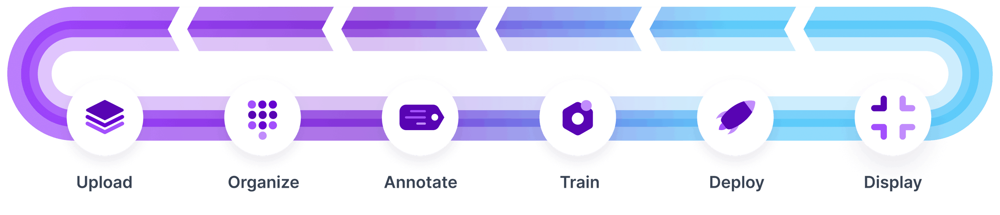

In [3]:
!pip install roboflow

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.4/46.4 KB 2.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 138.5/138.5 KB 7.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 KB 7.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 KB 9.9 MB/s eta 0:00:00
  Created wheel for wget: filename=wget-3.2-py3-none-any.whl size=9674 sha256=632bef9ef75e45168afe1732e9e69a09e4ff9683358bb390d1b8c8da319dba21
  Stored in directory: /root/.cache/pip/wheels/bd/a8/c3/3cf2c14a1837a4e04bd98631724e81f33f462d86a1d895fae0
Successfully built wget
  Attempting uninstall: urllib3
    Found existing installation: urllib3 1.24.3
    Uninstalling urllib3-1.24.3:
      Successfully uninstalled urllib3-1.24.3
  Attempting uninstall: pyparsing
    Found existing installation: pyparsing 3.0.9
    Uninstalling pypars

In [4]:
from roboflow import Roboflow
VERSION = 4
rf = Roboflow(api_key="3rOW8xY5g1wv0JEQF2Vl")
project = rf.workspace("miguel-alejandro-ponce-proano").project("dataset-gun-segmented")
dataset = project.version(VERSION).download("folder")

loading Roboflow workspace...
loading Roboflow project...
Exporting format folder in progress : 85.0%
Version export complete for folder format


Extracting Dataset Version Zip to dataset-gun-segmented-4 in folder:: 100%|██████████| 926/926 [00:00<00:00, 5370.32it/s]


In [5]:
dataset_path = "./{fpath}-{fversion}".format(fpath="dataset-gun-segmented",fversion=VERSION)
dataset_path

'./dataset-gun-segmented-4'

## Librerías

In [6]:
import tensorflow as tf
import os
import pathlib
import time
import datetime
from matplotlib import pyplot as plt
from IPython import display
import glob
from pathlib import Path
from PIL import Image
import random
import matplotlib.image as mpimg
import numpy as np
import cv2

## Constantes

In [7]:
PATH = dataset_path
BUFFER_SIZE = 400
BATCH_SIZE = 1
IMG_WIDTH = 512
IMG_HEIGHT = 512
SEMILLA_ALEATORIA = 1234
np.random.seed(SEMILLA_ALEATORIA)

## Clases

In [8]:
class ImageEvaluatorUtil:
  def __init__(self,sourcePath) -> None:    
    self.sourcePath = sourcePath     

  def graficarImagenes(self):    
    # create figure
    path = self.sourcePath+"/*.jpg"    
    images = glob.glob(path)
    print(images)
    rows = 2
    columns = 3
    listImages = np.random.choice(images, size=rows*columns)
    
    fig = plt.figure(figsize=(20, 10))
    # setting values to rows and column variables
        
    # reading images
    for i in range(1,rows*columns+1):
      imagePath = listImages[i-1]           
      fig.add_subplot(rows, columns, i)
      image = mpimg.imread(imagePath)      
      plt.imshow(image)
      plt.axis('off')
      plt.title(f"ID:{i}")
    
  def graficarImagenesCarga(self,load):    
    # create figure
    path = self.sourcePath+"/*.jpg"    
    images = glob.glob(path)
    print(images)
    rows = 4
    columns = 4
    listImages = np.random.choice(images, size=rows*columns)
    
    fig = plt.figure(figsize=(20, 10))
    # setting values to rows and column variables
        
    # reading images
    k = 0
    for i in range(1,rows*columns+1,2):
      imagePath = listImages[k]  
      inp, re = load(imagePath)
      # Casting to int for matplotlib to display the images
      fig.add_subplot(rows, columns, i)
      image = mpimg.imread(imagePath)      
      plt.imshow(inp / 255.0)
      plt.axis('off')
      plt.title(f"ID:{i}")
      fig.add_subplot(rows, columns, i+1)
      plt.imshow(re / 255.0)
      plt.axis('off')
      plt.title(f"ID:{i}")
      k = k + 1
      
      #plt.figure()
      #plt.imshow(inp / 255.0)
      #plt.figure()
      #plt.imshow(re / 255.0)

  def getPathTestImage(self):    
    # create figure
    path = self.sourcePath+"/*.jpg"    
    images = glob.glob(path)
    return np.random.choice(images)
  
  def getRandomPathImages(self):    
    # create figure
    path = self.sourcePath+"/*.jpg"    
    images = glob.glob(path)
    return np.random.choice(images, size=20)


## Visualización de las imágenes





Cada imagen  tiene un tamaño de **512 x 1024** pixeles, y se subdivide en   dos imágenes de tamaño **512 x 512** pixeles, a la izquierda esta la imágen segementada y a la derecha la imagen original. 

In [9]:
pathTrain = f"{PATH}/test/person"
imageEvaluatorUtil = ImageEvaluatorUtil(pathTrain)

['./dataset-gun-segmented-4/test/person/mgd_custom_frame1742_jpg.rf.f7f1bad97e87585a7ea249ad6b75348b.jpg', './dataset-gun-segmented-4/test/person/mgd_custom_frame1616_jpg.rf.1d2650a97265d919757d4febb318f1ad.jpg', './dataset-gun-segmented-4/test/person/caleb-hernandez-belmonte-QunXlN13l0U-unsplash_jpg.rf.ffa0a9bfd1d043fae1a7b1af71df0294.jpg', './dataset-gun-segmented-4/test/person/0020836832_jpg.rf.43d306c4df91070a65903c87cbd0e798.jpg', './dataset-gun-segmented-4/test/person/001431528_jpg.rf.8cc64e1c36840b2cdc9266a7f8a3b695.jpg', './dataset-gun-segmented-4/test/person/010711252_jpg.rf.8d760d9a9a32e6ce2ea313c916f153a9.jpg', './dataset-gun-segmented-4/test/person/011501094_jpg.rf.78097bde6e1975817873ba7509a424a4.jpg', './dataset-gun-segmented-4/test/person/mock_attack_frame533_jpg.rf.b664e23c336e3960a901b29a027bd732.jpg', './dataset-gun-segmented-4/test/person/t1adId2zTnQ_30_60_000091_jpg.rf.3a9c10f8fc4f0b042f94b74337d79f3e.jpg', './dataset-gun-segmented-4/test/person/images-4-_jpg.rf.4d5

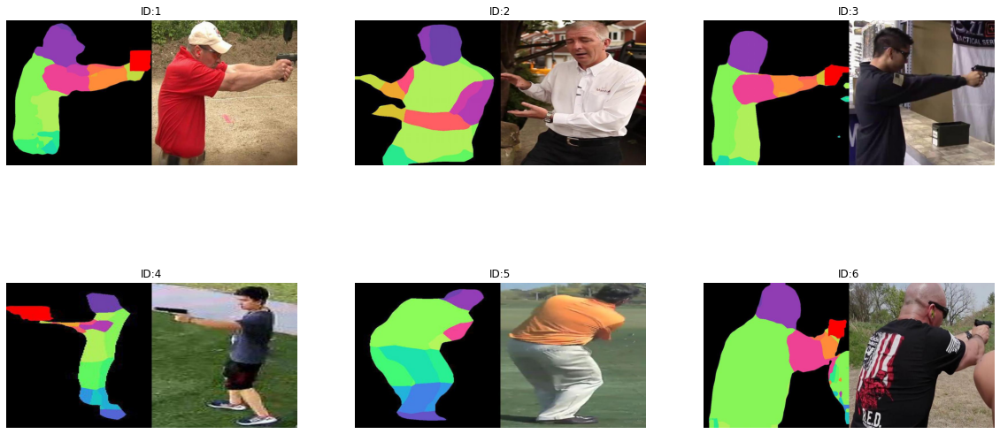

In [10]:
imageEvaluatorUtil.graficarImagenes()

Es necesario separar las imágenes de la persona real de las imágenes segmentadas, cuyo tamaño de 512x512 píxeles.

Se crea una función para la  carga de estas imagenes y que generan dos tensores uno por cada imagen:

In [11]:
def load(image_file):
  # Carga el tensor
  image = tf.io.read_file(image_file)
  image = tf.io.decode_jpeg(image)

  # Divide la imagen 
  w = tf.shape(image)[1]
  w = w // 2
  # oRIGINAL
  input_image = image[:, w:, :]
  real_image = image[:, :w, :]
  #real_image = image[:, w:, :]
  #input_image = image[:, :w, :]

  # Convert both images to float32 tensors
  input_image = tf.cast(input_image, tf.float32)
  real_image = tf.cast(real_image, tf.float32)

  return input_image, real_image

Se muestra de las imágenes de entrada a la derecha real y a la izquierda la mima imagen pero segmentada.

['./dataset-gun-segmented-4/test/person/mgd_custom_frame1742_jpg.rf.f7f1bad97e87585a7ea249ad6b75348b.jpg', './dataset-gun-segmented-4/test/person/mgd_custom_frame1616_jpg.rf.1d2650a97265d919757d4febb318f1ad.jpg', './dataset-gun-segmented-4/test/person/caleb-hernandez-belmonte-QunXlN13l0U-unsplash_jpg.rf.ffa0a9bfd1d043fae1a7b1af71df0294.jpg', './dataset-gun-segmented-4/test/person/0020836832_jpg.rf.43d306c4df91070a65903c87cbd0e798.jpg', './dataset-gun-segmented-4/test/person/001431528_jpg.rf.8cc64e1c36840b2cdc9266a7f8a3b695.jpg', './dataset-gun-segmented-4/test/person/010711252_jpg.rf.8d760d9a9a32e6ce2ea313c916f153a9.jpg', './dataset-gun-segmented-4/test/person/011501094_jpg.rf.78097bde6e1975817873ba7509a424a4.jpg', './dataset-gun-segmented-4/test/person/mock_attack_frame533_jpg.rf.b664e23c336e3960a901b29a027bd732.jpg', './dataset-gun-segmented-4/test/person/t1adId2zTnQ_30_60_000091_jpg.rf.3a9c10f8fc4f0b042f94b74337d79f3e.jpg', './dataset-gun-segmented-4/test/person/images-4-_jpg.rf.4d5

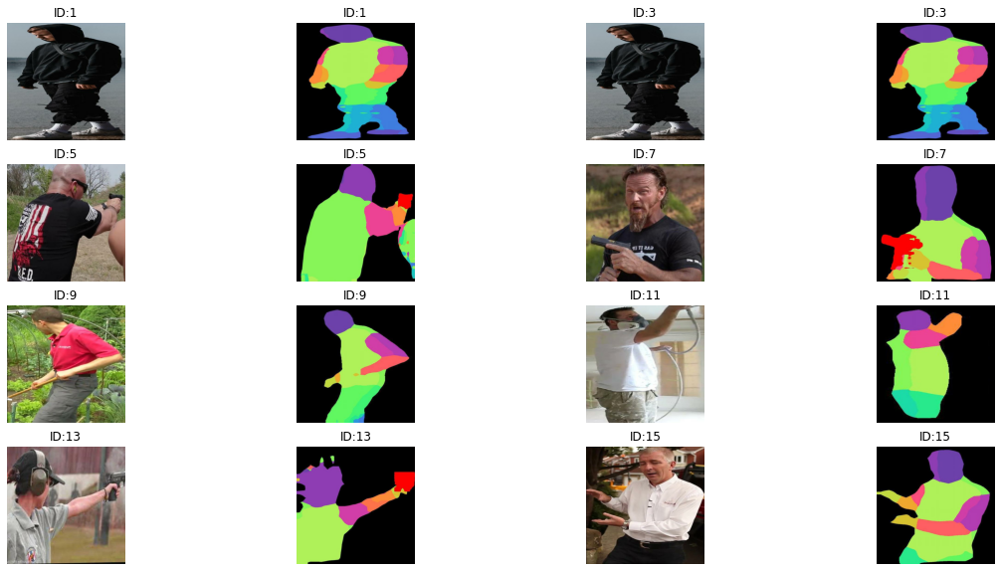

In [12]:
imageEvaluatorUtil.graficarImagenesCarga(load)

Se aplica rotaciones y reflejos aleatorios para preprocesar el conjunto de entrenamiento.

Defina varias funciones que:

1. Se cambiar el tamaño de cada imagen `512 x 512` a una mayor altura y anchura: `598 x 598`.
2. Se recorta aleatoriamente a `512 x 512`.
3. Se voltea aleatoriamente la imagen horizontalmente, es decir, de izquierda a derecha (espejo aleatorio).
4. Se Normaliza las imágenes al rango `[-1, 1]`.

In [13]:
def resize(input_image, real_image, height, width):
  input_image = tf.image.resize(input_image, [height, width],
                                method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
  real_image = tf.image.resize(real_image, [height, width],
                               method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)

  return input_image, real_image

In [14]:
def random_crop(input_image, real_image):
  stacked_image = tf.stack([input_image, real_image], axis=0)
  cropped_image = tf.image.random_crop(
      stacked_image, size=[2, IMG_HEIGHT, IMG_WIDTH, 3])

  return cropped_image[0], cropped_image[1]

In [15]:
# Normalizing the images to [-1, 1]
def normalize(input_image, real_image):
  input_image = (input_image / 127.5) - 1
  real_image = (real_image / 127.5) - 1

  return input_image, real_image

In [16]:
@tf.function()
def random_jitter(input_image, real_image):
  # Resizing to 286x286  
  input_image, real_image = resize(input_image, real_image, IMG_HEIGHT+10, IMG_WIDTH+10)

  # Random cropping back to 512x512
  input_image, real_image = random_crop(input_image, real_image)

  if tf.random.uniform(()) > 0.5:
    # Random mirroring
    input_image = tf.image.flip_left_right(input_image)
    real_image = tf.image.flip_left_right(real_image)

  return input_image, real_image

Resultado:

In [17]:
inp, re = load(imageEvaluatorUtil.getPathTestImage())

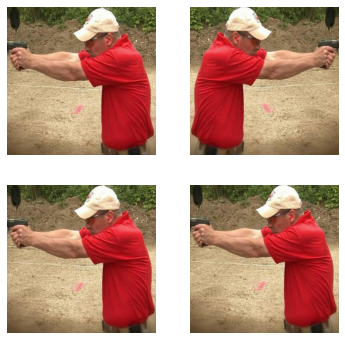

In [18]:
plt.figure(figsize=(6, 6))
for i in range(4):
  rj_inp, rj_re = random_jitter(inp, re)
  plt.subplot(2, 2, i + 1)
  plt.imshow(rj_inp / 255.0)
  plt.axis('off')
plt.show()

Se crean las funciones auxiliares para cargar y preprocesar los conjuntos de entrenamiento y prueba:

In [19]:
def load_image_train(image_file):
  input_image, real_image = load(image_file)
  input_image, real_image = random_jitter(input_image, real_image)
  input_image, real_image = normalize(input_image, real_image)

  return input_image, real_image

In [20]:
def load_image_test(image_file):
  input_image, real_image = load(image_file)
  input_image, real_image = resize(input_image, real_image,
                                   IMG_HEIGHT, IMG_WIDTH)
  input_image, real_image = normalize(input_image, real_image)

  return input_image, real_image

## Separación de los datos de entrenamiento y test

### Train data set

In [21]:
train_dataset = tf.data.Dataset.list_files(os.path.join(PATH,'train/person/*.jpg'))
train_dataset = train_dataset.map(load_image_train,
                                  num_parallel_calls=tf.data.AUTOTUNE)
train_dataset = train_dataset.shuffle(BUFFER_SIZE)
train_dataset = train_dataset.batch(BATCH_SIZE)

### Test data set

In [22]:
try:
  test_dataset = tf.data.Dataset.list_files(os.path.join(PATH,'test/person/*.jpg'))
except tf.errors.InvalidArgumentError:
  test_dataset = tf.data.Dataset.list_files(os.path.join(PATH,'val/person/*.jpg'))
test_dataset = test_dataset.map(load_image_test)
test_dataset = test_dataset.batch(BATCH_SIZE)

## Generador


El generador de la red pix2pix cGAN es un U-Net modificado. Una U-Net consta de un codificador (disminución de muestreo) y un decodificador (disminución de muestreo).  En donde cada bloque del codificador esta formado por: Convolution -> Batch normalization -> Leaky ReLU. Cada bloque en el decodificador es: Transposed convolution -> Batch normalization -> Dropout (applied to the first 3 blocks) -> ReLU.

Existen conexiones de salto entre el codificador y el decodificador.


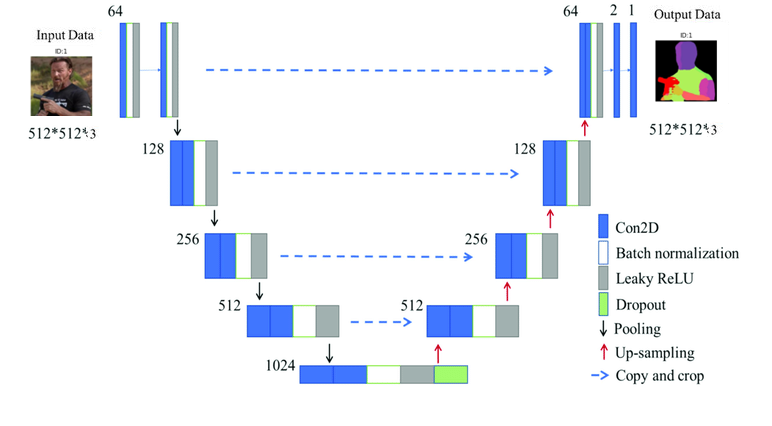

Definir el codificador(downsampler):

In [23]:
OUTPUT_CHANNELS = 3

In [24]:
def downsample(filters, size, apply_batchnorm=True):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
      tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                             kernel_initializer=initializer, use_bias=False))

  if apply_batchnorm:
    result.add(tf.keras.layers.BatchNormalization())

  result.add(tf.keras.layers.LeakyReLU())

  return result

In [25]:
down_model = downsample(3, 4)
down_result = down_model(tf.expand_dims(inp, 0))
print (down_result.shape)

(1, 256, 256, 3)



Defina el decodificador(upsampler):

In [26]:
def upsample(filters, size, apply_dropout=False):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
    tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
                                    padding='same',
                                    kernel_initializer=initializer,
                                    use_bias=False))

  result.add(tf.keras.layers.BatchNormalization())

  if apply_dropout:
      result.add(tf.keras.layers.Dropout(0.5))

  result.add(tf.keras.layers.ReLU())

  return result

In [27]:
up_model = upsample(3, 4)
up_result = up_model(down_result)
print (up_result.shape)

(1, 512, 512, 3)


Creamos la función generador con el downsampler y el upsampler:

In [28]:
def Generator():  
  inputs = tf.keras.layers.Input(shape=[IMG_WIDTH, IMG_HEIGHT, 3])

  down_stack = [
    downsample(64, 4, apply_batchnorm=False),  # (batch_size, 128, 128, 64)
    downsample(128, 4),  # (batch_size, 64, 64, 128)
    downsample(256, 4),  # (batch_size, 32, 32, 256)
    downsample(512, 4),  # (batch_size, 16, 16, 512)
    downsample(512, 4),  # (batch_size, 8, 8, 512)
    downsample(512, 4),  # (batch_size, 4, 4, 512)
    downsample(512, 4),  # (batch_size, 2, 2, 512)
    downsample(512, 4),  # (batch_size, 1, 1, 512)
  ]

  up_stack = [
    upsample(512, 4, apply_dropout=True),  # (batch_size, 2, 2, 1024)
    upsample(512, 4, apply_dropout=True),  # (batch_size, 4, 4, 1024)
    upsample(512, 4, apply_dropout=True),  # (batch_size, 8, 8, 1024)
    upsample(512, 4),  # (batch_size, 16, 16, 1024)
    upsample(256, 4),  # (batch_size, 32, 32, 512)
    upsample(128, 4),  # (batch_size, 64, 64, 256)
    upsample(64, 4),  # (batch_size, 128, 128, 128)
  ]

  initializer = tf.random_normal_initializer(0., 0.02)
  last = tf.keras.layers.Conv2DTranspose(OUTPUT_CHANNELS, 4,
                                         strides=2,
                                         padding='same',
                                         kernel_initializer=initializer,
                                         activation='tanh')  # (batch_size, 256, 256, 3)

  x = inputs

  # Downsampling through the model
  skips = []
  for down in down_stack:
    x = down(x)
    skips.append(x)

  skips = reversed(skips[:-1])  

  # Upsampling and establishing the skip connections
  k = 1
  for up, skip in zip(up_stack, skips):    
    x = up(x)
    x = tf.keras.layers.Concatenate()([x, skip])  
  x = last(x)

  return tf.keras.Model(inputs=inputs, outputs=x)

## Arquitectura del generador

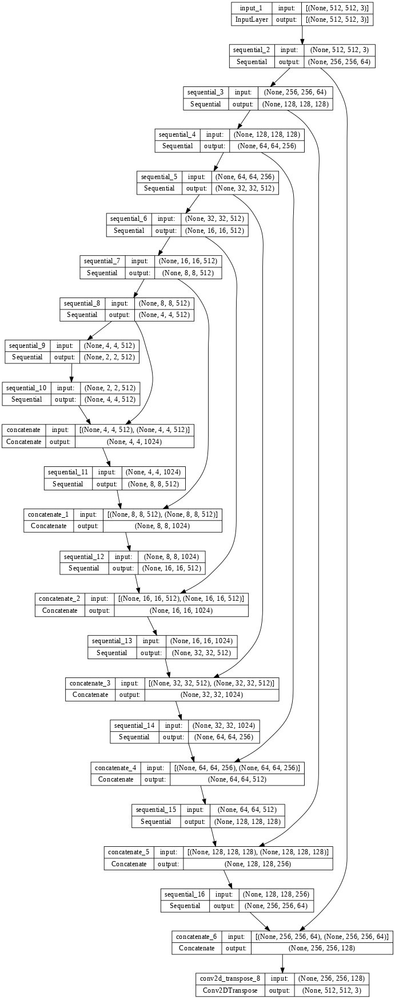

In [29]:
generator = Generator()
tf.keras.utils.plot_model(generator, show_shapes=True, dpi=64)

Probamos en generador:

In [30]:
inp[tf.newaxis, ...].shape

TensorShape([1, 512, 512, 3])

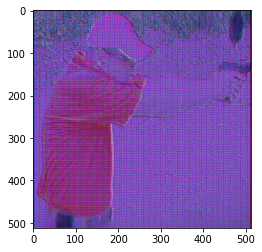

In [31]:
gen_output = generator(inp[tf.newaxis, ...], training=False)
plt.imshow(gen_output[0, ...])

## Pérdida del generador
Las cGAN aprenden de una pérdida que penaliza una posible estructura que difiere de la salida de la red y la imagen de destino, como se describe en el artículo [Image-to-Image Translation with Conditional Adversarial Networks](https://arxiv.org/pdf/1611.07004.pdf).

- **gan_loss**, es la pérdida del generador es una pérdida de entropía cruzada sigmoidea de las imágenes generadas y una matriz de unos.
- **L1**, es una pérdida que mide el MAE (error absoluto medio) entre la imagen generada y la imagen de destino. Esto permite que la imagen generada se vuelva estructuralmente similar a la imagen de destino.

La fórmula para calcular la **pérdida total del generador** es la suma de la perdida de la red GAN(gan_loss) + LAMBDA * l1_loss, donde LAMBDA = 100.

In [32]:
LAMBDA = 100

In [33]:
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [34]:
def generator_loss(disc_generated_output, gen_output, target):
  gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)

  # Mean absolute error
  l1_loss = tf.reduce_mean(tf.abs(target - gen_output))

  total_gen_loss = gan_loss + (LAMBDA * l1_loss)

  return total_gen_loss, gan_loss, l1_loss

## Procedimiento de entrenamiento para el generador

![Generator Update Image](https://github.com/tensorflow/docs/blob/master/site/en/tutorials/generative/images/gen.png?raw=1)


## Discriminador

PatchGAN es un tipo de discriminador para redes antagónicas generativas que solo penaliza la estructura a escala de parches de imagen locales. El discriminador PatchGAN intenta clasificar si cada parche en una imagen es real o falso. Este discriminador se ejecuta de forma convolucional a través de la imagen, promediando todas las respuestas para proporcionar el resultado final. Dicho discriminador modela efectivamente la imagen como un campo aleatorio de Markov, suponiendo independencia entre píxeles separados por más de un diámetro de parche. Puede entenderse como un tipo de pérdida de textura/estilo.

El discriminador es un clasificador PatchGAN convolucional que intenta clasificar si cada imagen _parche_ es real o no, como se describe en el artículo de pix2pix.

- Cada bloque en el discriminador es: Convolution -> Batch normalization -> Leaky ReLU.
- La forma de la salida después de la última capa es `(batch_size, 30, 30, 1)`.
- Cada parche de imagen `30 x 30` de la salida clasifica una porción `70 x 70` de la imagen de entrada.
- El discriminador recibe 2 entradas:
    - La imagen de entrada y la imagen de destino, que debe clasificar como *real*.
    - La imagen de entrada y la imagen generada (la salida del generador), que debe clasificar como *false*.
    - Utiliza `tf.concatenate([inp, tar], axis=-1)` para concatenar estas 2 entradas juntas.

In [35]:
def Discriminator():
  initializer = tf.random_normal_initializer(0., 0.02)

  inp = tf.keras.layers.Input(shape=[IMG_WIDTH, IMG_HEIGHT, 3], name='input_image')
  tar = tf.keras.layers.Input(shape=[IMG_WIDTH, IMG_HEIGHT, 3], name='target_image')

  x = tf.keras.layers.concatenate([inp, tar])  # (batch_size, 512, 512, channels*2)

  down1 = downsample(64, 4, False)(x)  # (batch_size, 128, 128, 64)
  down2 = downsample(128, 4)(down1)  # (batch_size, 64, 64, 128)
  down3 = downsample(256, 4)(down2)  # (batch_size, 32, 32, 256)

  zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3)  # (batch_size, 34, 34, 256)
  conv = tf.keras.layers.Conv2D(512, 4, strides=1,
                                kernel_initializer=initializer,
                                use_bias=False)(zero_pad1)  # (batch_size, 31, 31, 512)

  batchnorm1 = tf.keras.layers.BatchNormalization()(conv)

  leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)

  zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu)  # (batch_size, 33, 33, 512)

  last = tf.keras.layers.Conv2D(1, 4, strides=1,
                                kernel_initializer=initializer)(zero_pad2)  # (batch_size, 30, 30, 1)

  return tf.keras.Model(inputs=[inp, tar], outputs=last)

## Arquitectura del discriminador

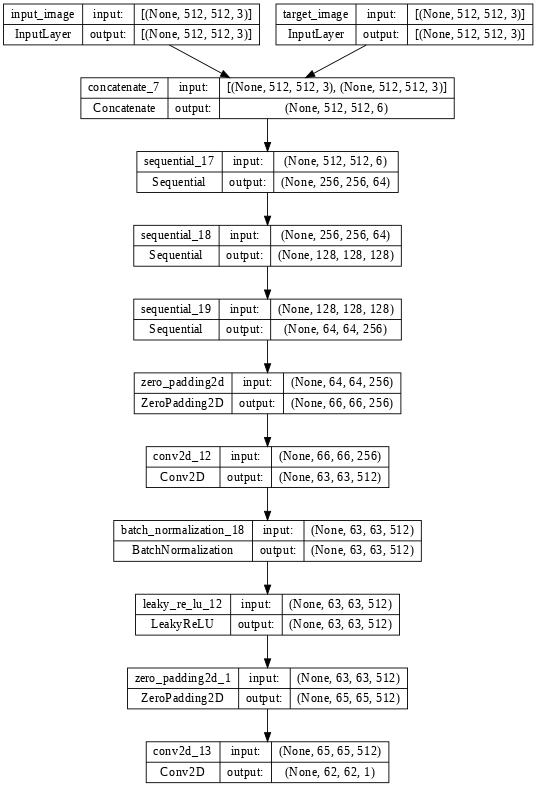

In [36]:
discriminator = Discriminator()
tf.keras.utils.plot_model(discriminator, show_shapes=True, dpi=64)

Validamos el discriminador:

In [37]:
inp[tf.newaxis, ...].shape

TensorShape([1, 512, 512, 3])

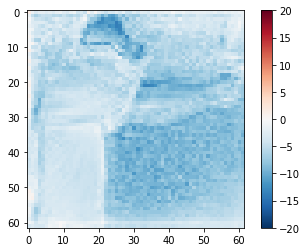

In [38]:
disc_out = discriminator([inp[tf.newaxis, ...], gen_output], training=False)
plt.imshow(disc_out[0, ..., -1], vmin=-20, vmax=20, cmap='RdBu_r')
plt.colorbar()

## Pérdida del discriminador
La función discriminator_loss tiene 2 entradas: las imágenes reales y las imágenes generadas.
- **real_loss** es una pérdida de entropía cruzada sigmoidea de las imágenes reales y una matriz de unos (ya que estas son las imágenes reales).
- **generated_loss** es una pérdida de entropía cruzada sigmoidea de las imágenes generadas y una matriz de ceros (ya que estas son las imágenes falsas).

La pérdida total es la suma de la pérdida real y la pérdida generada.

In [39]:
def discriminator_loss(disc_real_output, disc_generated_output):
  real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)

  generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)

  total_disc_loss = real_loss + generated_loss

  return total_disc_loss

## Procedimiento de entrenamiento para el discriminador

![Discriminator Update Image](https://github.com/tensorflow/docs/blob/master/site/en/tutorials/generative/images/dis.png?raw=1)


## Definir los optimizadores y un punto de control(checkpoint)


In [40]:
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

In [41]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

## Generar imágenes durante entrenamiento

Perimte graficas las imágenes durante el entrenamiento.

- Pasar imágenes de prueba al generador.
- El generador luego traducirá la imagen de entrada a la salida.
- El último paso realizar las predicciones.

In [42]:
def generate_images(model, test_input, tar):
  prediction = model(test_input, training=True)
  plt.figure(figsize=(15, 15))

  display_list = [test_input[0], tar[0], prediction[0]]
  title = ['Input Image', 'Ground Truth', 'Predicted Image']

  for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.title(title[i])
    # Getting the pixel values in the [0, 1] range to plot.
    plt.imshow(display_list[i] * 0.5 + 0.5)
    plt.axis('off')
  plt.show()

Ejemplo ejecución función de generación:

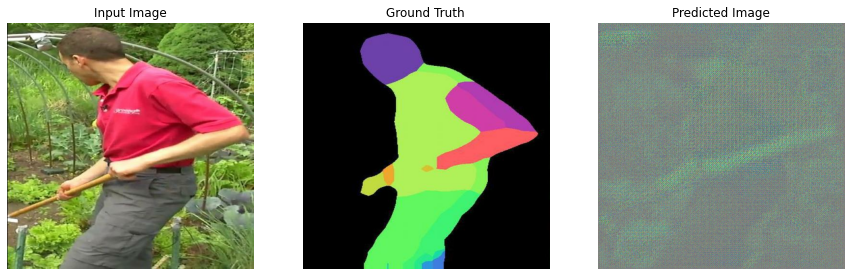

In [43]:
for example_input, example_target in test_dataset.take(1):
  generate_images(generator, example_input, example_target)

## Entrenamiento


El proceso es el siguiente:
- Para cada imagen  de entrada genera una imagen de salida.
- El discriminador recibe la `imagen_de_entrada` y la imagen generada como primera entrada. La segunda entrada es `input_image` y `target_image`.
- Calcular el generador y la pérdida del discriminador.
- Calcular las pérdidas con respecto tanto al generador y al discriminador(entradas) y se deben aplicar al optimizador.

In [44]:
!rm -rf "./logs/"

In [45]:
log_dir="./logs/"

summary_writer = tf.summary.create_file_writer(
  log_dir + "fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

In [46]:
@tf.function
def train_step(input_image, target, step):
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    gen_output = generator(input_image, training=True)

    disc_real_output = discriminator([input_image, target], training=True)
    disc_generated_output = discriminator([input_image, gen_output], training=True)

    gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(disc_generated_output, gen_output, target)
    disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

  generator_gradients = gen_tape.gradient(gen_total_loss,
                                          generator.trainable_variables)
  discriminator_gradients = disc_tape.gradient(disc_loss,
                                               discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(generator_gradients,
                                          generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(discriminator_gradients,
                                              discriminator.trainable_variables))

  with summary_writer.as_default():
    tf.summary.scalar('gen_total_loss', gen_total_loss, step=step//1000)
    tf.summary.scalar('gen_gan_loss', gen_gan_loss, step=step//1000)
    tf.summary.scalar('gen_l1_loss', gen_l1_loss, step=step//1000)
    tf.summary.scalar('disc_loss', disc_loss, step=step//1000)

## Visualización entrenamiento
* 1k pasos: borre la pantalla y ejecuta generate_images para mostrar el progreso.
* 5k pasos: guarda un punto de control.

In [47]:
def fit(train_ds, test_ds, steps):  
  start = time.time()
  example_input, example_target = next(iter(test_ds.take(1)))
  for step, (input_image, target) in train_ds.repeat().take(steps).enumerate():    
    if (step) % 1000 == 0:
      example_input_intro, example_target_intro = next(iter(test_ds.take(1)))
      display.clear_output(wait=True)

      if step != 0:
        print(f'Time taken for 1000 steps: {time.time()-start:.2f} sec\n')

      start = time.time()

      generate_images(generator, example_input, example_target)
      print(f"Step: {step//1000}k")

      generate_images(generator, example_input_intro, example_target_intro)
      print(f"Step: {step//1000}k")

    train_step(input_image, target, step)

    # Training step
    if (step+1) % 10 == 0:
      print('.', end='', flush=True)


    # Save (checkpoint) the model every 5k steps
    if (step + 1) % 5000 == 0:
      checkpoint.save(file_prefix=checkpoint_prefix)

Luego del entrenamiento guarda registros que se pueden ver en TensorBoard para monitorear el progreso del entrenamiento.

Ejecutar el ciclo de entrenamiento:

Time taken for 1000 steps: 34.51 sec



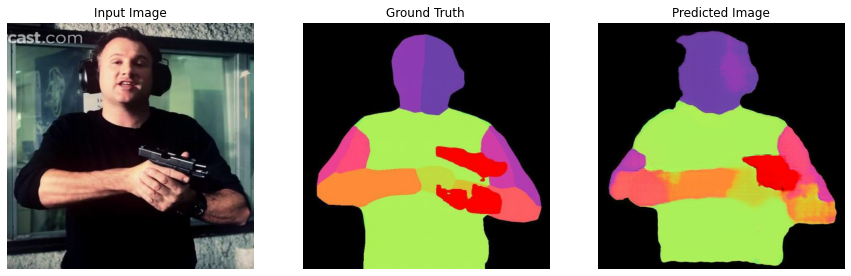

Step: 59k


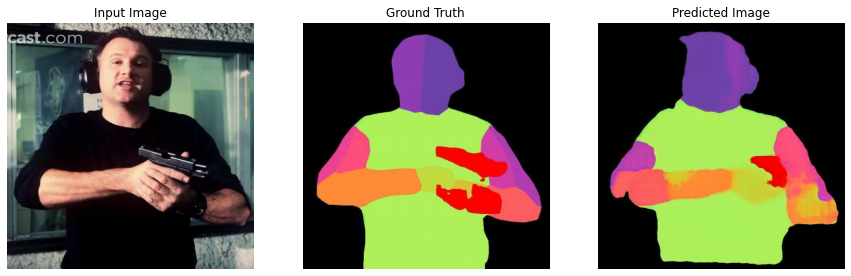

Step: 59k
....................................................................................................

In [48]:
fit(train_dataset, test_dataset, steps=60000)

# Métricas

In [49]:
%load_ext tensorboard
%tensorboard --logdir {log_dir}

<IPython.core.display.Javascript object>

La interpretación de los registros es más compleja y abstracta cuando se entrena una GAN (o una cGAN como pix2pix) respecto de otro modelos como clasificación o regresión. Por ejemplo:

Debido a que se busca el equilibrio en la red según la teoría de Nashm se puede comprobar que ni el generador ni el discriminador han "ganado". 
* Debido a que gen_gan_loss o disc_loss son muy altos, es un indicador que el modelo combinado está entrenando correctamente .
El valor log(3) = 0,47 es un buen punto de referencia las pérdidas, ya que indica una perplejidad de 3: el discriminador, en promedio, tiene la misma incertidumbre sobre las dos opciones.
* Para disc_loss, un valor por debajo de 0,47 significa que el discriminador lo está buscando discriminar de manerar aleatoria en el conjunto combinado de imágenes reales y generadas.
* Para gen_gan_loss, un valor por debajo de  0,47 significa que el generador lo está haciendo mejor que el azar para engañar al discriminador.
* A medida que avanza el entrenamiento, gen_l1_loss sigue disminuyendo. Luego la pérdida L1, también conocida como pérdida de error absoluta, que es la diferencia absoluta entre una predicción y el valor real. La pérdida L1 es un cálculo de error para cada ejemplo en el que queremos comprender qué tan bien predijimos para esa observación; luego un L1 que disminuye y tiende a cero es un buen indicador.

## Librerias

In [50]:
from math import floor
from numpy import ones
from numpy import expand_dims
from numpy import log
from numpy import mean
from numpy import std
from numpy import exp
from numpy.random import shuffle
from keras.applications.inception_v3 import InceptionV3
from keras.applications.inception_v3 import preprocess_input
from keras.datasets import cifar10
from skimage.transform import resize
from numpy import asarray
from keras import backend as K
from sklearn.metrics import confusion_matrix  
import numpy as np
from skimage.color import rgb2gray
from skimage.filters import threshold_minimum

## Inception Score

La puntuación es una medida de cuán realista es la salida de una GAN. En palabras de sus autores, “encontramos que [el IS] se correlaciona bien con la evaluación humana [de la calidad de la imagen]”. Es una alternativa automática a que los humanos califiquen la calidad de las imágenes.

Inception Score mide dos cosas simultáneamente:

* Las imágenes tienen variedad (por ejemplo, cada imagen es una raza de perro diferente)
* Cada imagen claramente se parece a algo diferente.

Si ambas cosas son ciertas, la puntuación será alta. Si uno o ambos son falsos, la puntuación será baja.

Una puntuación más alta es mejor. Significa que su GAN puede generar muchas imágenes distintas diferentes.

La puntuación más baja posible es cero. Matemáticamente, la puntuación más alta posible es infinito, aunque en la práctica probablemente surgirá un techo no infinito¹.

El IS ha demostrado ser útil y popular, aunque tiene limitaciones.

In [51]:
def generate_images_metricas(model, test_input, tar):
  prediction = model(test_input, training=True)  
  return test_input[0], tar[0], prediction[0]

In [52]:
listTar = []
listTarBinary = []
listPred = []
listPredBinary = []
index = 0

def converBinary(image):
  gray_image_pred = rgb2gray(image)
  return gray_image_pred > 0.29

thresh_pred = 0
for inp, tar in train_dataset.take(300):
  index = index + 1  
  input, tar, prediction = generate_images_metricas(generator, inp, tar)
  imgTar = tf.keras.utils.img_to_array(tar)* 0.5+0.5
  imgPred = tf.keras.utils.img_to_array(prediction)* 0.5+0.5  
  listTar.append(imgTar)
  listPred.append(imgPred)
  listTarBinary.append(converBinary(imgTar))
  listPredBinary.append(converBinary(imgPred))

In [53]:
print("Lista Esperada",len(listTar))
print("Lista Predicha",len(listPred))

Lista Esperada 300
Lista Predicha 300


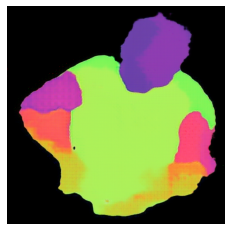

In [54]:
# Getting the pixel values in the [0, 1] range to plot.
plt.imshow(listPred[0])
plt.axis('off')
plt.show()

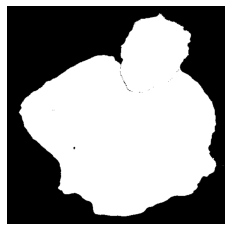

In [55]:
# Getting the pixel values in the [0, 1] range to plot.
plt.imshow(listPredBinary[0], cmap='gray')
plt.axis('off')
plt.show()

In [56]:
# scale an array of images to a new size
def scale_images(images, new_shape):
 images_list = list()
 for image in images:
 # resize with nearest neighbor interpolation
    new_image = resize(image, new_shape, 0)
    # store
    images_list.append(new_image)
 return asarray(images_list)
 
# assumes images have any shape and pixels in [0,255]
def calculate_inception_score(images, n_split=10, eps=1E-16):
 # load inception v3 model
 model = InceptionV3()
 # enumerate splits of images/predictions
 scores = list()
 n_part = floor(images.shape[0] / n_split)
 for i in range(n_split):
    # retrieve images
    ix_start, ix_end = i * n_part, (i+1) * n_part
    subset = images[ix_start:ix_end]
    # convert from uint8 to float32
    subset = subset.astype('float32')
    # scale images to the required size
    subset = scale_images(subset, (299,299,3))
    # pre-process images, scale to [-1,1]
    subset = preprocess_input(subset)
    # predict p(y|x)
    p_yx = model.predict(subset)
    # calculate p(y)
    p_y = expand_dims(p_yx.mean(axis=0), 0)
    # calculate KL divergence using log probabilities
    kl_d = p_yx * (log(p_yx + eps) - log(p_y + eps))
    # sum over classes
    sum_kl_d = kl_d.sum(axis=1)
    # average over images
    avg_kl_d = mean(sum_kl_d)
    # undo the log
    is_score = exp(avg_kl_d)
    # store
    scores.append(is_score)
    # average across images
    is_avg, is_std = mean(scores), std(scores)
    return is_avg, is_std
# calculate inception score
is_avg, is_std = calculate_inception_score(asarray(listPred))
print('score', is_avg, is_std)

1/1 [==============================] - 2s 2s/step
score 1.0133815 0.0


## Intersection over Union Coef

Esta métrica es muchas más interesante, también conocido como Índice Jaccard, es una de las métricas más utilizadas en la segmentación semántica. El IoU es el área de superposición entre la segmentación predicha y la verdadera. Esta métrica varía de 0 a 1 (0 a 100 %), donde 0 significa que no hay superposición y 1 significa una segmentación perfectamente superpuesta. Como se puede ver la métrica tiene un valor de 0.9043723442467624, lo que indica que el modelo está generando máscaras de segmentos muy parecido a la imagen original

In [57]:
def compute_iou(y_pred, y_true):
    # ytrue, ypred is a flatten vector
    y_pred = y_pred.flatten()
    y_true = y_true.flatten()
    current = confusion_matrix(y_true, y_pred, labels=[0, 1])
    # compute mean iou
    intersection = np.diag(current)
    ground_truth_set = current.sum(axis=1)
    predicted_set = current.sum(axis=0)
    union = ground_truth_set + predicted_set - intersection
    IoU = intersection / union.astype(np.float32)
    return np.mean(IoU)

In [58]:
def calculate_iou_coef(imagesReal,imagesPred):
  coef = 0
  for i in range(0,len(imagesReal)):
    coef += compute_iou(imagesReal[i],imagesPred[i])
  return coef/len(imagesReal)

In [59]:
def intersection_of_union(im1, im2):
    i = np.logical_and(im1, im2)
    u = np.logical_or(im1, im2)
    return i.sum() / u.sum()


In [60]:
calculate_iou_coef(listTarBinary,listPredBinary)

0.9031050379384091

## Dice

El índice de Dice es muy similar al índice de Jaccard, ya que mide la similitud y diversidad de conjuntos de muestras. Aunque se calculan de manera similar, el índice de Dice es un poco más intuitivo porque se puede ver como el porcentaje de superposición entre dos conjuntos, que es un valor entre 0 y 1. Para este trabajo el índice es de 0.90 pro tanto se están solapando las imágenes real y predicha.

In [61]:
from scipy.spatial import distance
def calculate_iou_coef(imagesReal,imagesPred):
  coef = 0
  for i in range(0,len(imagesReal)):    
    coef += dice_coeficient(imagesReal[i], imagesPred[i]) 
  return coef/len(imagesReal)

In [62]:
def dice_coeficient(mask1, mask2):
    intersect = np.sum(mask1*mask2)
    fsum = np.sum(mask1)
    ssum = np.sum(mask2)
    dice = (2 * intersect ) / (fsum + ssum)
    dice = np.mean(dice)
    dice = round(dice, 3) # for easy reading
    return dice    

In [63]:
calculate_iou_coef(listTarBinary,listPredBinary)

0.9362466666666662

## Predicciones 
Para esto se toma el último punto de control.

In [64]:
!ls {checkpoint_dir}

checkpoint		     ckpt-4.data-00000-of-00001
ckpt-10.data-00000-of-00001  ckpt-4.index
ckpt-10.index		     ckpt-5.data-00000-of-00001
ckpt-11.data-00000-of-00001  ckpt-5.index
ckpt-11.index		     ckpt-6.data-00000-of-00001
ckpt-12.data-00000-of-00001  ckpt-6.index
ckpt-12.index		     ckpt-7.data-00000-of-00001
ckpt-1.data-00000-of-00001   ckpt-7.index
ckpt-1.index		     ckpt-8.data-00000-of-00001
ckpt-2.data-00000-of-00001   ckpt-8.index
ckpt-2.index		     ckpt-9.data-00000-of-00001
ckpt-3.data-00000-of-00001   ckpt-9.index
ckpt-3.index


In [65]:
tf.train.latest_checkpoint(checkpoint_dir)

'./training_checkpoints/ckpt-12'

In [66]:
# Restoring the latest checkpoint in checkpoint_dir
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

## Mostrar predicciones

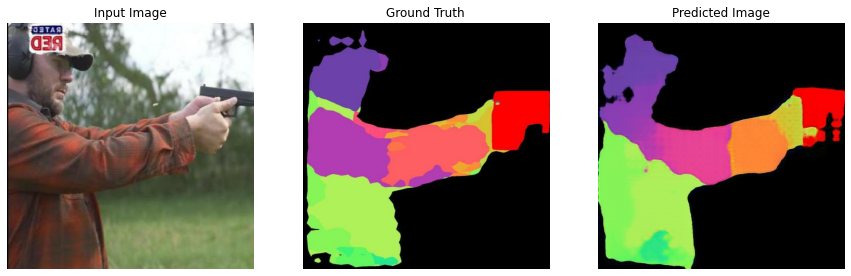

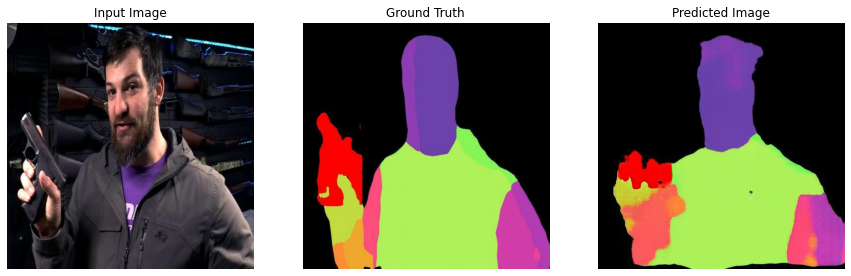

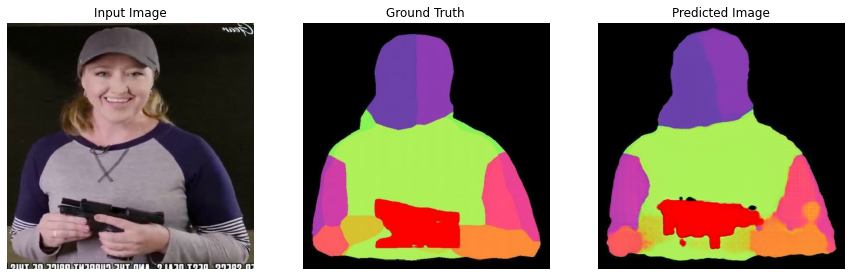

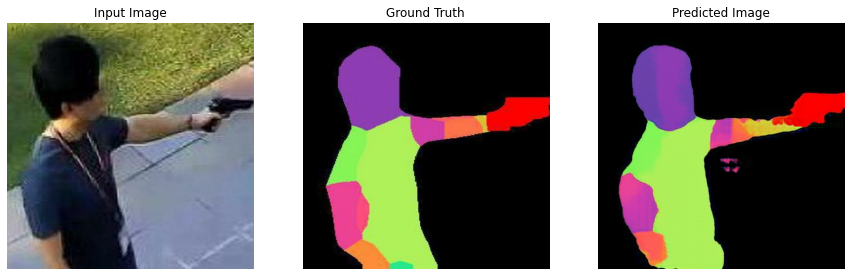

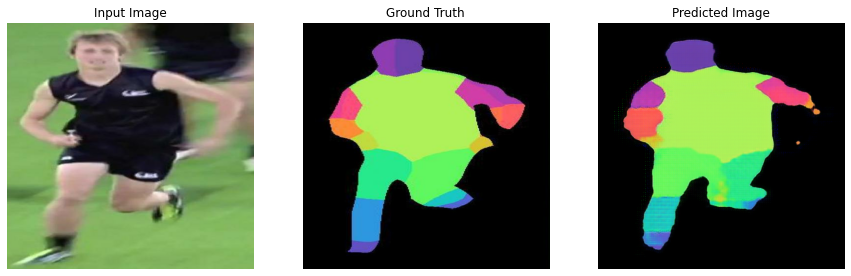

...

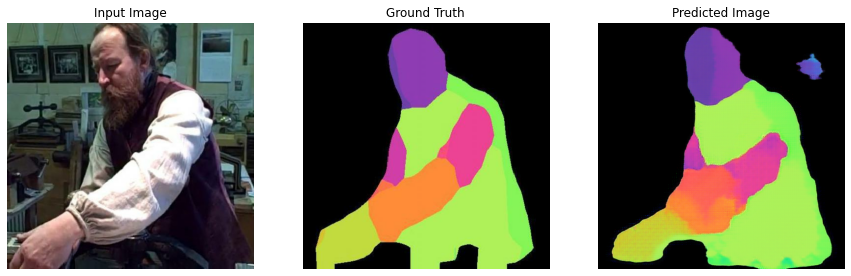

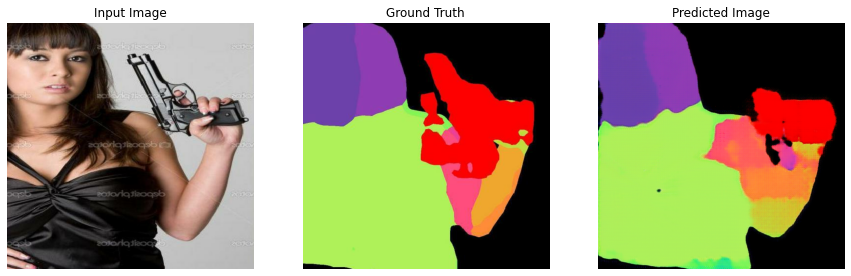

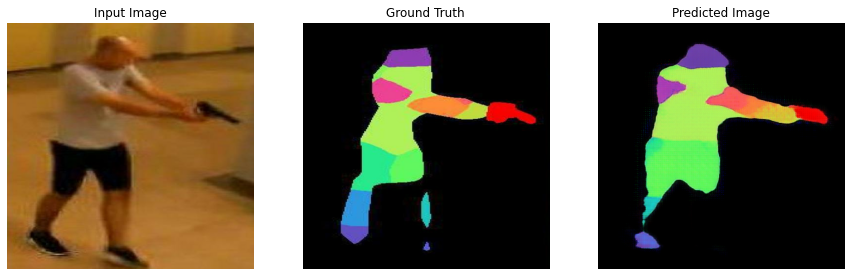

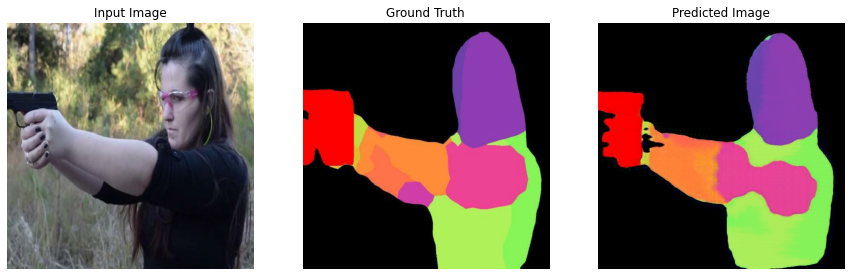

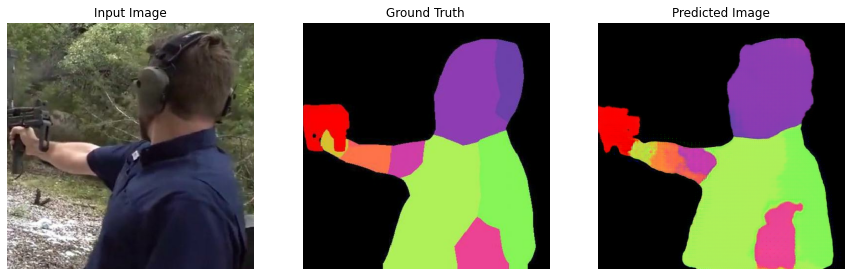

In [67]:
# Run the trained model on a few examples from the test set
for inp, tar in train_dataset.take(20):
  generate_images(generator, inp, tar)

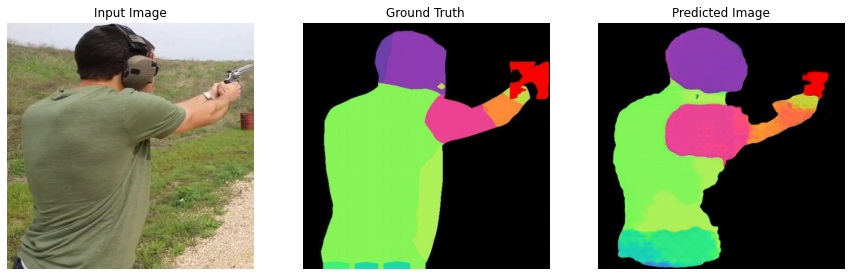

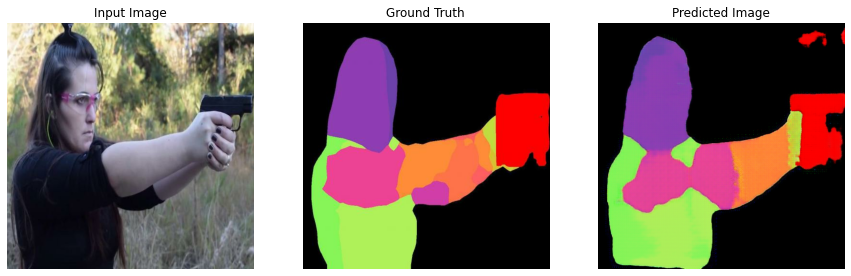

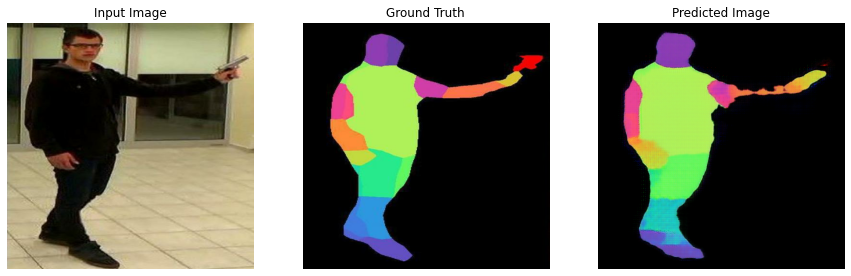

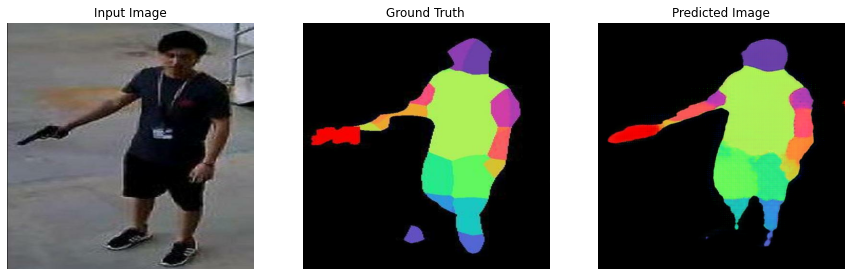

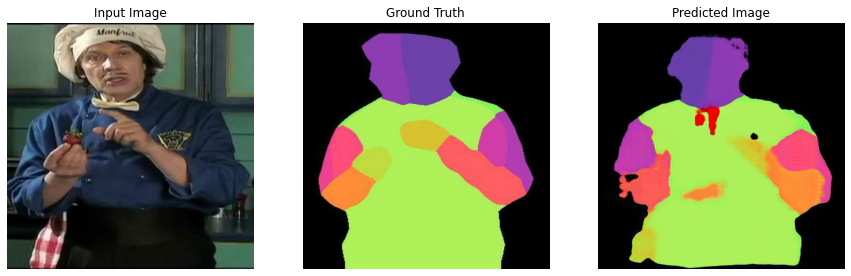

...

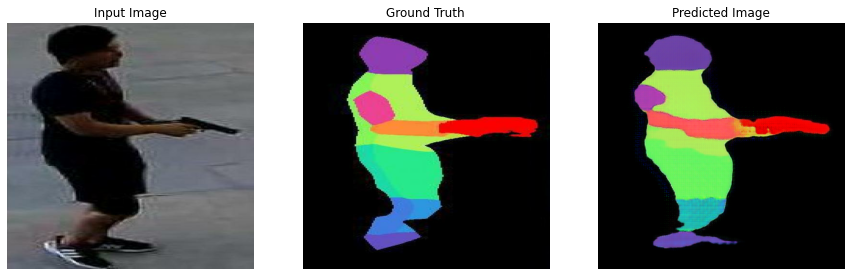

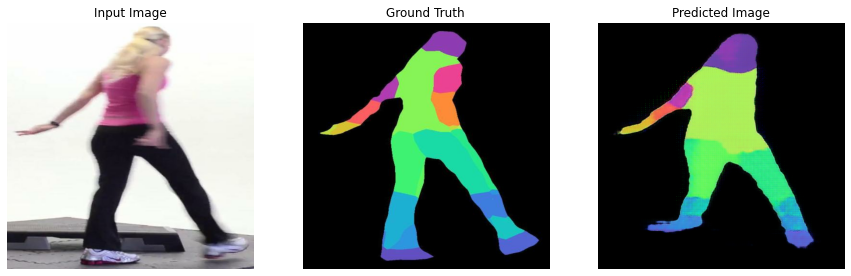

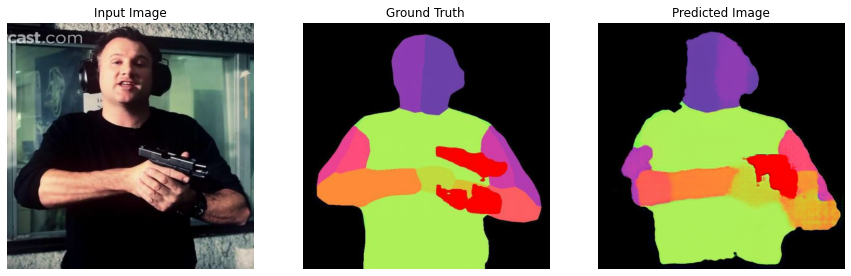

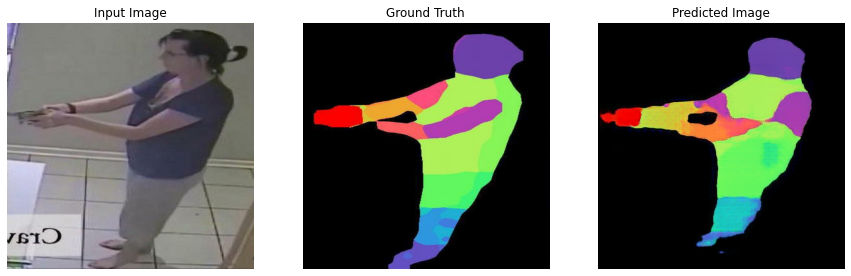

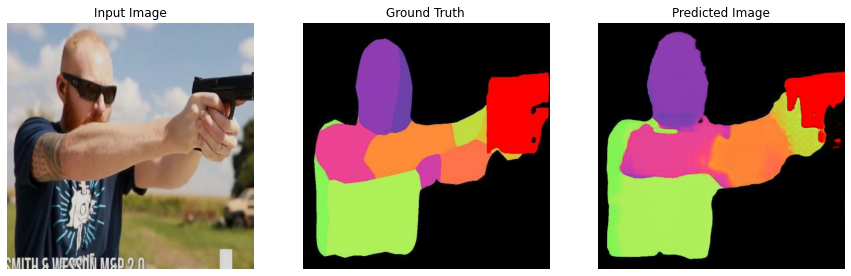

In [68]:
# Run the trained model on a few examples from the test set
for inp, tar in test_dataset.take(20):
  generate_images(generator, inp, tar)

## Ejemplo funciones Pile Line

In [69]:
def generate_images_predict(model, test_input):
  prediction = model(test_input, training=True)
  plt.figure(figsize=(15, 15))

  display_list = [test_input[0], prediction[0]]
  title = ['Input Image', 'Predicted Image']

  for i in range(2):
    plt.subplot(1, 2, i+1)
    plt.title(title[i])
    # Getting the pixel values in the [0, 1] range to plot.
    plt.imshow(display_list[i] * 0.5 + 0.5)
    plt.axis('off')
  plt.show()

def load_predict(image_file):
  # Carga el tensor
  image = tf.io.read_file(image_file)
  image = tf.io.decode_jpeg(image)

  # Divide la imagen 
  w = tf.shape(image)[1]
  w = w // 2
  # oRIGINAL
  input_image = image[:, w:, :]
  real_image = image[:, :w, :]
  #real_image = image[:, w:, :]
  #input_image = image[:, :w, :]

  # Convert both images to float32 tensors
  input_image = tf.cast(input_image, tf.float32)
  real_image = tf.cast(real_image, tf.float32)

  return input_image, real_image



def load_image_predict(image_file):
  input_image, real_image = load_predict(image_file)
  #input_image, real_image = random_jitter(input_image, real_image)
  input_image, real_image = normalize(input_image, real_image)

  return input_image, real_image

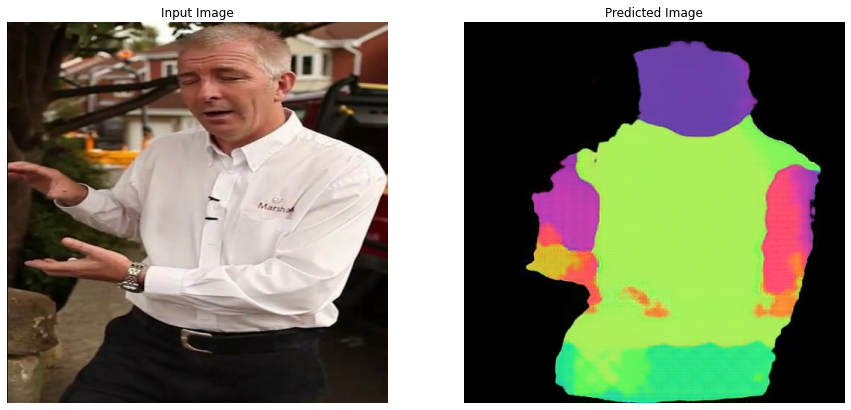

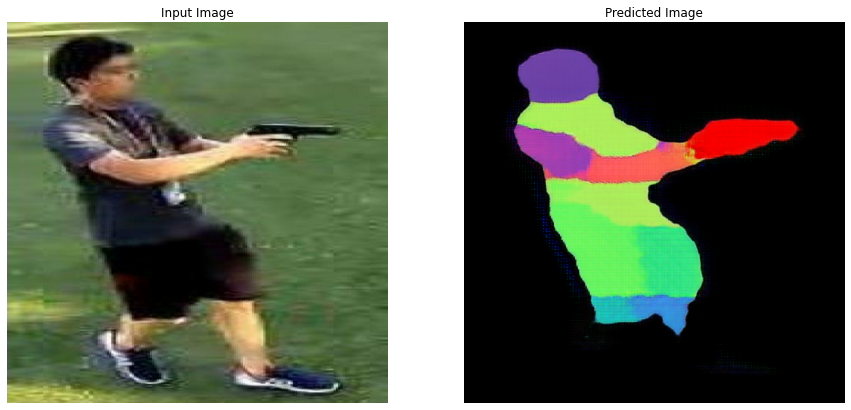

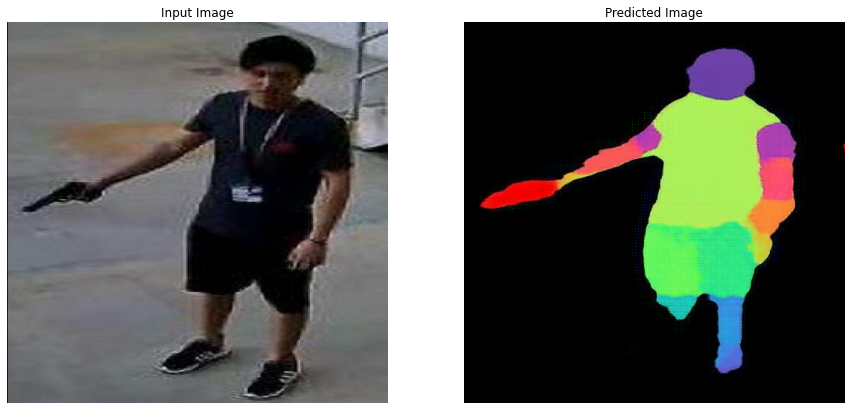

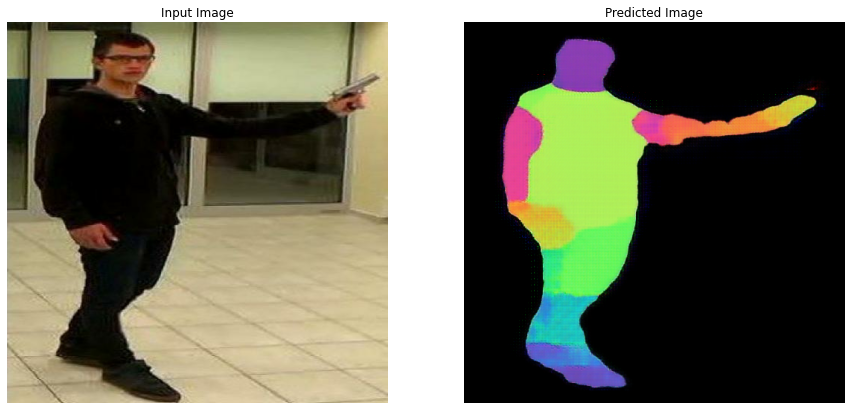

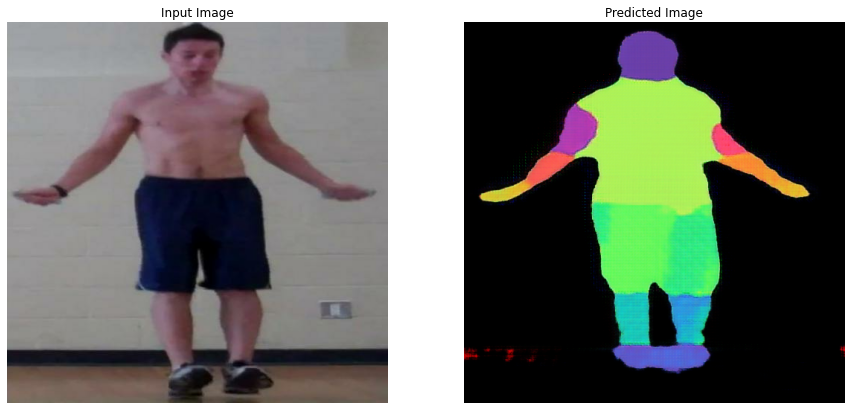

...

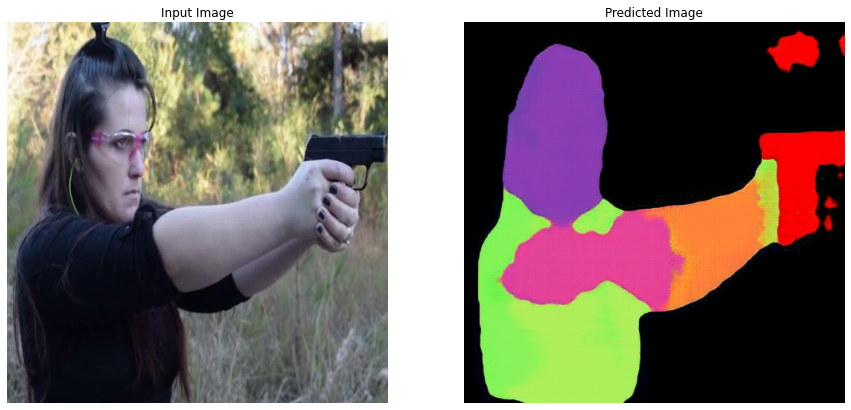

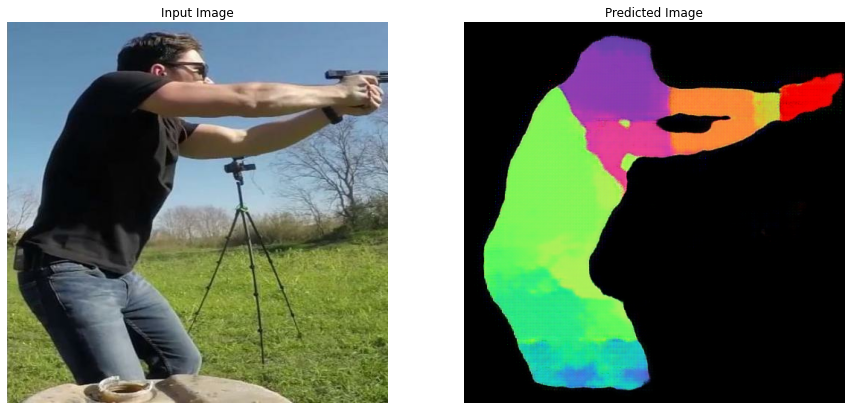

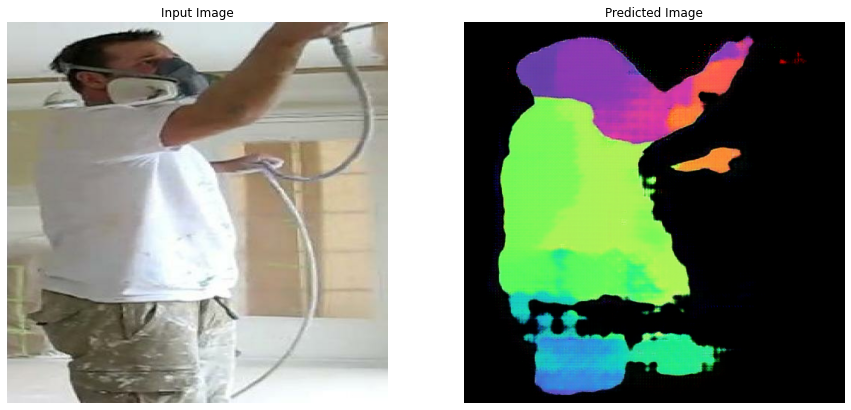

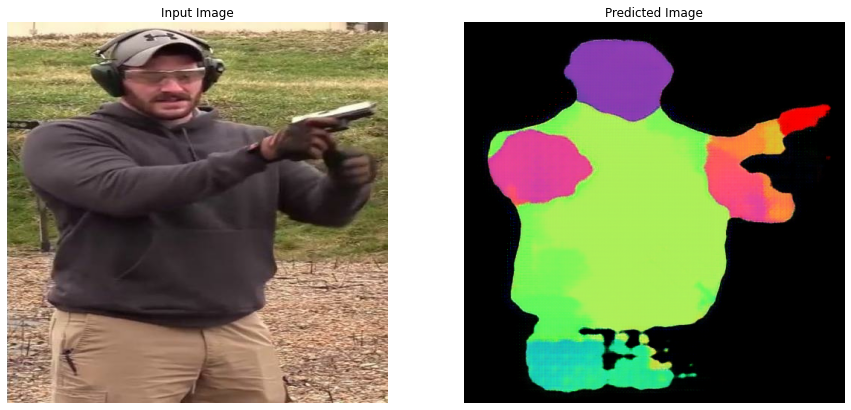

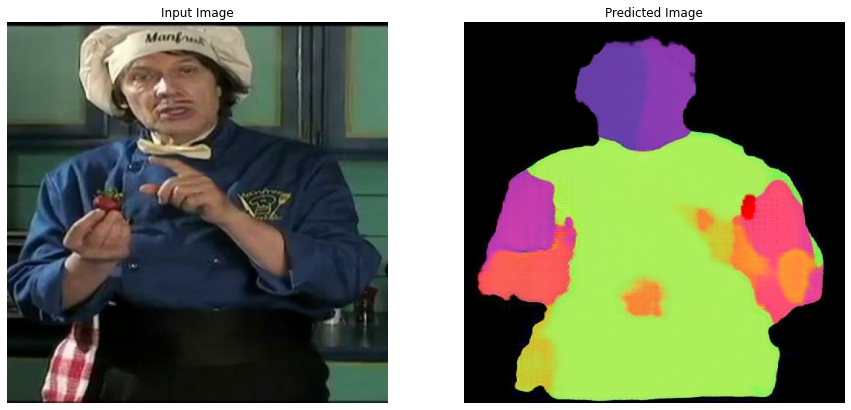

In [70]:
pathImages = imageEvaluatorUtil.getRandomPathImages()
for path in pathImages:
  inptest, re = load_image_predict(path)
  generate_images_predict(generator, inptest[tf.newaxis, ...])

# MontarDrive

In [72]:
import os
from google.colab import drive
ROOT_FOLDER='/content/'
ROOT_DRIVE_FOLDER=ROOT_FOLDER+'drive/'
drive.mount(ROOT_DRIVE_FOLDER)

Mounted at /content/drive/


In [78]:
!rm -rf model-gan-segmentantion-person-armed-512
!mkdir model-gan-segmentantion-person-armed-512

In [79]:
!cp ./training_checkpoints/ckpt-12.data-00000-of-00001  ./model-gan-segmentantion-person-armed-512


In [80]:
!cp ./training_checkpoints/ckpt-12.index ./model-gan-segmentantion-person-armed-512

In [81]:
!cp -r ./logs ./model-gan-segmentantion-person-armed-512

In [82]:
!tar -czvf model-gan-segmentantion-person-armed-512.tar.gz "./model-gan-segmentantion-person-armed-512"

./model-gan-segmentantion-person-armed-512/
./model-gan-segmentantion-person-armed-512/logs/
./model-gan-segmentantion-person-armed-512/logs/fit/
./model-gan-segmentantion-person-armed-512/logs/fit/20230112-153701/
./model-gan-segmentantion-person-armed-512/logs/fit/20230112-153701/events.out.tfevents.1673537821.ca189a583b77.949.0.v2
./model-gan-segmentantion-person-armed-512/ckpt-12.data-00000-of-00001
./model-gan-segmentantion-person-armed-512/ckpt-12.index


In [83]:
!cp --suffix=_v_$(date +"%y-%m-%d--%T")  ./model-gan-segmentantion-person-armed-512.tar.gz /content/drive/MyDrive/tmf-person-data/models/gans-unet